<a href="https://colab.research.google.com/github/nayachuks/ProgrammingAssignment2/blob/master/housing_price_pred.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import sklearn

In [ ]:
renting_data = pd.read_csv('/content/drive/MyDrive/ml_house_renting/housing_train.csv')
renting_data.head()

,id,url,region,region_url,price,type,sqfeet,beds,baths,cats_allowed,...,wheelchair_access,electric_vehicle_charge,comes_furnished,laundry_options,parking_options,image_url,description,lat,long,state
0,7039061606,https://bham.craigslist.org/apa/d/birmingham-h...,birmingham,https://bham.craigslist.org,1195,apartment,1908,3,2.0,1,...,0,0,0,laundry on site,street parking,https://images.craigslist.org/00L0L_80pNkyDeG0...,Apartments In Birmingham AL Welcome to 100 Inv...,33.4226,-86.7065,al
1,7041970863,https://bham.craigslist.org/apa/d/birmingham-w...,birmingham,https://bham.craigslist.org,1120,apartment,1319,3,2.0,1,...,0,0,0,laundry on site,off-street parking,https://images.craigslist.org/00707_uRrY9CsNMC...,Find Your Way to Haven Apartment Homes Come ho...,33.3755,-86.8045,al
2,7041966914,https://bham.craigslist.org/apa/d/birmingham-g...,birmingham,https://bham.craigslist.org,825,apartment,1133,1,1.5,1,...,0,0,0,laundry on site,street parking,https://images.craigslist.org/00h0h_b7Bdj1NLBi...,Apartments In Birmingham AL Welcome to 100 Inv...,33.4226,-86.7065,al
3,7041966936,https://bham.craigslist.org/apa/d/birmingham-f...,birmingham,https://bham.craigslist.org,800,apartment,927,1,1.0,1,...,0,0,0,laundry on site,street parking,https://images.craigslist.org/00808_6ghZ8tSRQs...,Apartments In Birmingham AL Welcome to 100 Inv...,33.4226,-86.7065,al
4,7041966888,https://bham.craigslist.org/apa/d/birmingham-2...,birmingham,https://bham.craigslist.org,785,apartment,1047,2,1.0,1,...,0,0,0,laundry on site,street parking,https://images.craigslist.org/00y0y_21c0FOvUXm...,Apartments In Birmingham AL Welcome to 100 Inv...,33.4226,-86.7065,al


In [ ]:
# To view the dimension/shape of the data
renting_data.shape

(265190, 22)

In [ ]:
renting_data.columns

Index(['id', 'url', 'region', 'region_url', 'price', 'type', 'sqfeet', 'beds',
       'baths', 'cats_allowed', 'dogs_allowed', 'smoking_allowed',
       'wheelchair_access', 'electric_vehicle_charge', 'comes_furnished',
       'laundry_options', 'parking_options', 'image_url', 'description', 'lat',
       'long', 'state'],
      dtype='object')

In [ ]:
# Checking for missing values
renting_data.isna().sum()

,0
id,0
url,0
region,0
region_url,0
price,0
type,0
sqfeet,0
beds,0
baths,0
cats_allowed,0


From the size of the data, the number of missing values in longitude and latitude are less than 1% of the data. therefore, dropping them will be ideal because it is likely that these missing values occure at similar rows in the two columns

In [ ]:
renting_data.dropna(axis = 'index', how = 'all', subset =  ['lat', 'long'], inplace = True)

In [ ]:
renting_data.isna().sum()

,0
id,0
url,0
region,0
region_url,0
price,0
type,0
sqfeet,0
beds,0
baths,0
cats_allowed,0


In [ ]:
renting_data.shape

(263771, 22)

In [ ]:
#To make a copy of my original data
renting_data2 = renting_data.copy()

In [ ]:
renting_data2

,id,url,region,region_url,price,type,sqfeet,beds,baths,cats_allowed,...,wheelchair_access,electric_vehicle_charge,comes_furnished,laundry_options,parking_options,image_url,description,lat,long,state
0,7039061606,https://bham.craigslist.org/apa/d/birmingham-h...,birmingham,https://bham.craigslist.org,1195,apartment,1908,3,2.0,1,...,0,0,0,laundry on site,street parking,https://images.craigslist.org/00L0L_80pNkyDeG0...,Apartments In Birmingham AL Welcome to 100 Inv...,33.4226,-86.7065,al
1,7041970863,https://bham.craigslist.org/apa/d/birmingham-w...,birmingham,https://bham.craigslist.org,1120,apartment,1319,3,2.0,1,...,0,0,0,laundry on site,off-street parking,https://images.craigslist.org/00707_uRrY9CsNMC...,Find Your Way to Haven Apartment Homes Come ho...,33.3755,-86.8045,al
2,7041966914,https://bham.craigslist.org/apa/d/birmingham-g...,birmingham,https://bham.craigslist.org,825,apartment,1133,1,1.5,1,...,0,0,0,laundry on site,street parking,https://images.craigslist.org/00h0h_b7Bdj1NLBi...,Apartments In Birmingham AL Welcome to 100 Inv...,33.4226,-86.7065,al
3,7041966936,https://bham.craigslist.org/apa/d/birmingham-f...,birmingham,https://bham.craigslist.org,800,apartment,927,1,1.0,1,...,0,0,0,laundry on site,street parking,https://images.craigslist.org/00808_6ghZ8tSRQs...,Apartments In Birmingham AL Welcome to 100 Inv...,33.4226,-86.7065,al
4,7041966888,https://bham.craigslist.org/apa/d/birmingham-2...,birmingham,https://bham.craigslist.org,785,apartment,1047,2,1.0,1,...,0,0,0,laundry on site,street parking,https://images.craigslist.org/00y0y_21c0FOvUXm...,Apartments In Birmingham AL Welcome to 100 Inv...,33.4226,-86.7065,al
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
265184,7050888256,https://columbus.craigslist.org/apa/d/columbus...,columbus,https://columbus.craigslist.org,929,apartment,728,1,1.0,1,...,1,0,0,w/d in unit,off-street parking,https://images.craigslist.org/00v0v_cE9ismC2Ad...,"Designed with your comfort in mind, Bexley Hou...",39.9709,-82.9241,oh
265185,7050851033,https://columbus.craigslist.org/apa/d/columbus...,columbus,https://columbus.craigslist.org,0,apartment,1061,2,2.0,1,...,0,0,0,w/d in unit,detached garage,https://images.craigslist.org/00m0m_8wP9hX96TZ...,â BERKLEY HOUSE â Voted #1 BEST Communit...,40.0495,-83.0669,oh
265186,7050887997,https://columbus.craigslist.org/apa/d/grove-ci...,columbus,https://columbus.craigslist.org,1069,apartment,1020,2,1.5,1,...,0,0,0,w/d hookups,detached garage,https://images.craigslist.org/00N0N_ioCvFNCv24...,!!!!Tour today and receive $5 Starbucks gift c...,39.8408,-83.0804,oh
265187,7044801015,https://columbus.craigslist.org/apa/d/columbus...,columbus,https://columbus.craigslist.org,1507,apartment,1660,2,1.5,1,...,0,0,0,NaN,NaN,https://images.craigslist.org/00j0j_5EIRWzdHCV...,"The Commons at Olentangy4765 Blairfield Dr, Co...",40.0564,-83.0417,oh


Replacing missing data with random values

In [ ]:
# For the laundry options, we need random samples of  54127 data points. this can be implemented with a function
# but first the indexes of the random samples  have to be equal to their missing values index of the laundry options feature
renting_data2['laundry_options'].isna().sum()

54127

In [ ]:
renting_data2['laundry_options'].value_counts()/len(renting_data2)*100

,count
laundry_options,
w/d in unit,34.269499
w/d hookups,18.910343
laundry on site,14.826876
laundry in bldg,10.509874
no laundry on site,0.962957


In [ ]:
random_samples = renting_data2['laundry_options'].dropna().sample(54127, random_state=42)

random_samples

,laundry_options
127340,w/d hookups
13698,laundry in bldg
84659,w/d hookups
23479,laundry on site
153019,laundry in bldg
...,...
173505,w/d in unit
212938,w/d hookups
6695,laundry in bldg
40829,w/d in unit


In [ ]:
random_samples.index

Index([127340,  13698,  84659,  23479, 153019, 198378,  26856,  46295,  46206,
        43264,
       ...
        44935, 226095, 169166, 224975, 106173, 173505, 212938,   6695,  40829,
       243549],
      dtype='int64', length=54127)

In [ ]:
# create a filter
renting_data2[renting_data2['laundry_options'].isna()].index

Index([    10,     49,     62,     64,     65,     73,     77,     78,     79,
          101,
       ...
       265112, 265121, 265124, 265130, 265136, 265157, 265161, 265163, 265174,
       265187],
      dtype='int64', length=54127)

In [ ]:
random_samples.index = renting_data2[renting_data2['laundry_options'].isna()].index
random_samples.index

Index([    10,     49,     62,     64,     65,     73,     77,     78,     79,
          101,
       ...
       265112, 265121, 265124, 265130, 265136, 265157, 265161, 265163, 265174,
       265187],
      dtype='int64', length=54127)

In [ ]:
renting_data2.loc[renting_data['laundry_options'].isna(), 'laundry_options'] = random_samples

In [ ]:
renting_data2['laundry_options'].isna().sum()

0

<Axes: xlabel='laundry_options'>

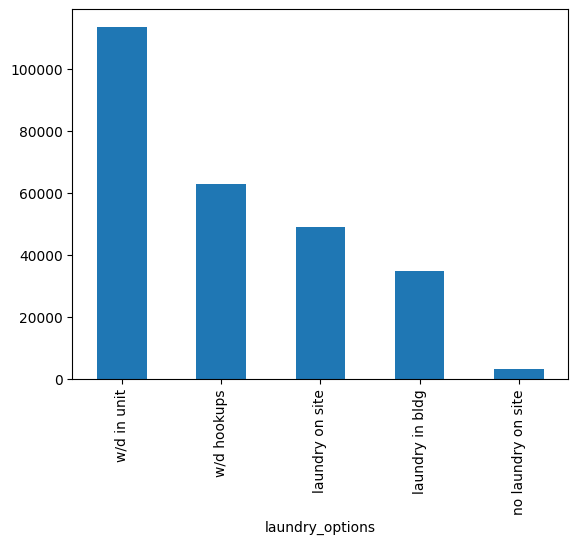

In [ ]:
renting_data2['laundry_options'].value_counts().plot(kind = 'bar')

In [ ]:
def impute_null_val(renting_data2, feature):
  random_samples = renting_data2[feature].dropna().sample(renting_data2[feature].isna().sum())
  random_samples.index = renting_data2[renting_data2[feature].isna()].index
  renting_data2.loc[renting_data2[feature].isna(), feature] = random_samples

In [ ]:
# imputation for "parking_options"
renting_data2['parking_options'].isna().sum()

94444

In [ ]:
renting_data2['parking_options'].value_counts()/len(renting_data2)*100

,count
parking_options,
off-street parking,33.399805
carport,10.848046
attached garage,10.316145
detached garage,4.838667
street parking,4.000061
no parking,0.745723
valet parking,0.046252


In [ ]:
impute_null_val(renting_data2, 'parking_options')

In [ ]:
renting_data2['parking_options'].value_counts()/len(renting_data2)*100

,count
parking_options,
off-street parking,51.985624
carport,16.902920
attached garage,16.095780
detached garage,7.523192
street parking,6.254668
no parking,1.165026
valet parking,0.072790


Wordcloud Analysis

A word cloud is a visualization of text where the size of each word indicates its frequency or importance within a text. Words that appear more often are shown in larger font sizes, and less frequent words appear smaller.

for visual representation of text data, the data should be in the following format:

List
string

In [ ]:
# word analysis for the "description" feature
renting_data2['description'][0]

'Apartments In Birmingham AL Welcome to 100 Inverness Apartment Homes, a luxury apartment community tucked away into one of the most coveted locations in the city for Birmingham apartments. Find stylish one-, two-, and three-bedroom apartment floor plans tailored to your wants and needs, complete with the amenities that are important to you. Our layouts come with just enough variety to enable you to make it your own haven unlike any other. Get inspired by our photos and the serenity of the nature surrounding you to let your aesthetic come together with our stylish, modern designs for a home you wonâ\x80\x99t be able to wait to show off to your guests. Even beyond style, our pet-friendly apartment community is also all about functionality! Some of our homes come with washer and dryer hookups, wood burning fireplaces, hardwood floors, and a private patio or balcony. All of our residents can make use of oversized walk-in closets, air conditioning, garages, a business center, on-site manag

In [ ]:
from wordcloud import WordCloud, STOPWORDS

In [ ]:
# Initialize an empty string to store the total concatenated text
total_description = ''

In [ ]:
# Set the STOPWORDS (common words like "and", "the", etc.) for filtering out later
STOPWORDS = set(STOPWORDS)

In [ ]:
#Iterate over the first 10,000 descriptions from the column
for value in renting_data2['description'][0:10000]:

  value = str(value) #Convert each description to a string in case it's not already

In [ ]:
# Split the description into individual words (tokens)
tokens = value.split()

In [ ]:
for i in range(len(tokens)): # Iterate through each word (token)
    tokens[i] = tokens[i].lower() # Convert each word to lowercase
    total_description = total_description + ' '.join(tokens) + '  ' # Concatenate the words into total_description

In [ ]:
total_description[0:100]

'apartment Options can end your search immediately and save you hundreds in Application Fees. We offe'

In [ ]:
# Creating a WordCloud from the processed text
wordcloud = WordCloud(width = 800, height = 800,
                background_color ='black',
                stopwords = STOPWORDS,
                min_font_size = 10).generate(total_description)

(-0.5, 799.5, 799.5, -0.5)

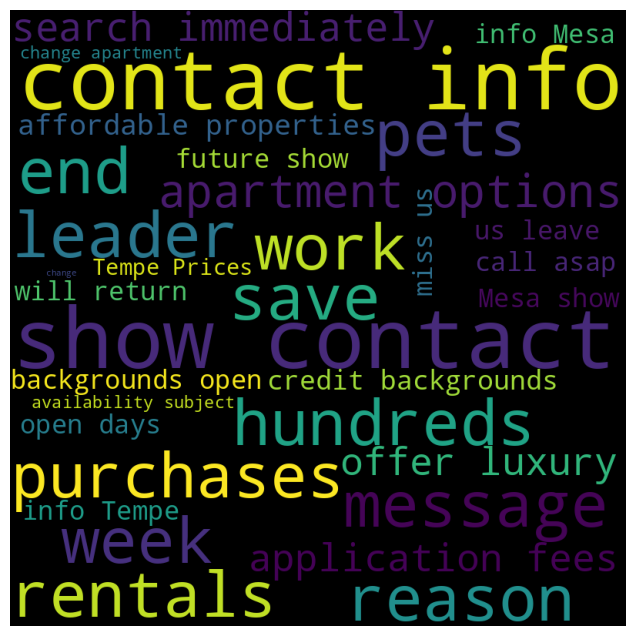

In [ ]:
# plot the generated wordcloud with
plt.figure(figsize = (8,8))
plt.imshow(wordcloud)
plt.axis('off')

**Cleaning the Description Feature**

In [ ]:
renting_data2['description'].isna().sum()

2

In [ ]:
renting_data2['description'].fillna('no description', inplace = True)

<ipython-input-36-a8e2a75d5689>:1: FutureWarning: A value is trying to be set on a copy of a DataFrame or Series through chained assignment using an inplace method.
The behavior will change in pandas 3.0. This inplace method will never work because the intermediate object on which we are setting values always behaves as a copy.

For example, when doing 'df[col].method(value, inplace=True)', try using 'df.method({col: value}, inplace=True)' or df[col] = df[col].method(value) instead, to perform the operation inplace on the original object.


  renting_data2['description'].fillna('no description', inplace = True)


In [ ]:
renting_data2['description'].isna().sum() # No more missing number

0

In [ ]:
renting_data2['description'] = renting_data2['description'].apply(lambda x: str(x).lower())

In [ ]:
renting_data2['description'][0]

'apartments in birmingham al welcome to 100 inverness apartment homes, a luxury apartment community tucked away into one of the most coveted locations in the city for birmingham apartments. find stylish one-, two-, and three-bedroom apartment floor plans tailored to your wants and needs, complete with the amenities that are important to you. our layouts come with just enough variety to enable you to make it your own haven unlike any other. get inspired by our photos and the serenity of the nature surrounding you to let your aesthetic come together with our stylish, modern designs for a home you wonâ\x80\x99t be able to wait to show off to your guests. even beyond style, our pet-friendly apartment community is also all about functionality! some of our homes come with washer and dryer hookups, wood burning fireplaces, hardwood floors, and a private patio or balcony. all of our residents can make use of oversized walk-in closets, air conditioning, garages, a business center, on-site manag

In [ ]:
from nltk.corpus import RegexpTokenizer

In [ ]:
tokenizer = RegexpTokenizer('[a-zA-Z]+')

In [ ]:
tokenizer

RegexpTokenizer(pattern='[a-zA-Z]+', gaps=False, discard_empty=True, flags=re.UNICODE|re.MULTILINE|re.DOTALL)

In [ ]:
print(tokenizer.tokenize(renting_data2['description'][0]))

['apartments', 'in', 'birmingham', 'al', 'welcome', 'to', 'inverness', 'apartment', 'homes', 'a', 'luxury', 'apartment', 'community', 'tucked', 'away', 'into', 'one', 'of', 'the', 'most', 'coveted', 'locations', 'in', 'the', 'city', 'for', 'birmingham', 'apartments', 'find', 'stylish', 'one', 'two', 'and', 'three', 'bedroom', 'apartment', 'floor', 'plans', 'tailored', 'to', 'your', 'wants', 'and', 'needs', 'complete', 'with', 'the', 'amenities', 'that', 'are', 'important', 'to', 'you', 'our', 'layouts', 'come', 'with', 'just', 'enough', 'variety', 'to', 'enable', 'you', 'to', 'make', 'it', 'your', 'own', 'haven', 'unlike', 'any', 'other', 'get', 'inspired', 'by', 'our', 'photos', 'and', 'the', 'serenity', 'of', 'the', 'nature', 'surrounding', 'you', 'to', 'let', 'your', 'aesthetic', 'come', 'together', 'with', 'our', 'stylish', 'modern', 'designs', 'for', 'a', 'home', 'you', 'won', 't', 'be', 'able', 'to', 'wait', 'to', 'show', 'off', 'to', 'your', 'guests', 'even', 'beyond', 'style', 

In [ ]:
sample = renting_data2.sample(10000)

In [ ]:
sample.head(2)

,id,url,region,region_url,price,type,sqfeet,beds,baths,cats_allowed,...,wheelchair_access,electric_vehicle_charge,comes_furnished,laundry_options,parking_options,image_url,description,lat,long,state
40239,7049977517,https://sandiego.craigslist.org/nsd/apa/d/san-...,san diego,https://sandiego.craigslist.org,2800,apartment,1113,2,2.0,0,...,0,0,0,laundry in bldg,off-street parking,https://images.craigslist.org/01111_8Mb89B9uLS...,to schedule a tour we now book our tour appoin...,32.8059,-117.2600,ca
160681,7041517283,https://batonrouge.craigslist.org/apa/d/brusly...,baton rouge,https://batonrouge.craigslist.org,1600,house,1550,3,2.0,0,...,0,0,0,w/d hookups,carport,https://images.craigslist.org/00h0h_hv4EfGwDwi...,"beautiful 3 bedroom 2 bath home in addis, la. ...",30.3671,-91.2711,la


In [ ]:
# Set a random seed before sampling rows
sample = sample.sample(frac=1, random_state=42)  # Shuffle rows with a fixed seed

# Apply the tokenizer to the shuffled sample
token_sample = sample['description'].apply(tokenizer.tokenize)

token_sample

,description
29092,"[if, your, or, over, we, would, like, to, rent..."
10510,"[welcome, home, welcome, to, sage, luxury, apa..."
97967,"[meridian, place, apartments, n, meridian, rd,..."
176539,"[large, and, sunny, bedroom, bathroom, apartme..."
250943,"[welcome, home, to, bennington, hills, searchi..."
...,...
199377,"[community, amenitiesswimming, pool, and, sun,..."
166603,"[castlewood, apartments, pet, friendly, commun..."
216489,"[the, province, greenville, has, a, convenient..."
188729,"[sign, a, month, lease, and, receive, call, to..."


In [ ]:
print(token_sample[232356])


['on', 'site', 'maintenance', 'two', 'resort', 'style', 'swimming', 'pools', 'photo', 'camera', 'package', 'receiving', 'spa', 'hot', 'tub', 'covered', 'parking', 'available', 'fitness', 'center', 'photo', 'camera', 'bark', 'park', 'photo', 'camera', 'availability', 'hours', 'racquetball', 'court', 'photo', 'camera', 'spin', 'room', 'photo', 'camera', 'controlled', 'access', 'gated', 'on', 'site', 'management', 'call', 'show', 'contact', 'info', 'for', 'more', 'information', 'visit', 'us', 'at', 'pricing', 'and', 'availability', 'subject', 'to', 'change', 'equal', 'housing', 'opportunity']


**prepare description feature using nltk**

In [ ]:
from nltk.corpus import stopwords

In [ ]:
import nltk
nltk.download('stopwords')

[nltk_data] Downloading package stopwords to /root/nltk_data...
[nltk_data]   Unzipping corpora/stopwords.zip.


True

In [ ]:
stop_wd = stopwords.words('english')

In [ ]:
print(stop_wd)

['i', 'me', 'my', 'myself', 'we', 'our', 'ours', 'ourselves', 'you', "you're", "you've", "you'll", "you'd", 'your', 'yours', 'yourself', 'yourselves', 'he', 'him', 'his', 'himself', 'she', "she's", 'her', 'hers', 'herself', 'it', "it's", 'its', 'itself', 'they', 'them', 'their', 'theirs', 'themselves', 'what', 'which', 'who', 'whom', 'this', 'that', "that'll", 'these', 'those', 'am', 'is', 'are', 'was', 'were', 'be', 'been', 'being', 'have', 'has', 'had', 'having', 'do', 'does', 'did', 'doing', 'a', 'an', 'the', 'and', 'but', 'if', 'or', 'because', 'as', 'until', 'while', 'of', 'at', 'by', 'for', 'with', 'about', 'against', 'between', 'into', 'through', 'during', 'before', 'after', 'above', 'below', 'to', 'from', 'up', 'down', 'in', 'out', 'on', 'off', 'over', 'under', 'again', 'further', 'then', 'once', 'here', 'there', 'when', 'where', 'why', 'how', 'all', 'any', 'both', 'each', 'few', 'more', 'most', 'other', 'some', 'such', 'no', 'nor', 'not', 'only', 'own', 'same', 'so', 'than', '

In [ ]:
rev = token_sample[232356]
print(rev)

['on', 'site', 'maintenance', 'two', 'resort', 'style', 'swimming', 'pools', 'photo', 'camera', 'package', 'receiving', 'spa', 'hot', 'tub', 'covered', 'parking', 'available', 'fitness', 'center', 'photo', 'camera', 'bark', 'park', 'photo', 'camera', 'availability', 'hours', 'racquetball', 'court', 'photo', 'camera', 'spin', 'room', 'photo', 'camera', 'controlled', 'access', 'gated', 'on', 'site', 'management', 'call', 'show', 'contact', 'info', 'for', 'more', 'information', 'visit', 'us', 'at', 'pricing', 'and', 'availability', 'subject', 'to', 'change', 'equal', 'housing', 'opportunity']


In [ ]:
print([token for token in rev if token not in stop_wd])

['site', 'maintenance', 'two', 'resort', 'style', 'swimming', 'pools', 'photo', 'camera', 'package', 'receiving', 'spa', 'hot', 'tub', 'covered', 'parking', 'available', 'fitness', 'center', 'photo', 'camera', 'bark', 'park', 'photo', 'camera', 'availability', 'hours', 'racquetball', 'court', 'photo', 'camera', 'spin', 'room', 'photo', 'camera', 'controlled', 'access', 'gated', 'site', 'management', 'call', 'show', 'contact', 'info', 'information', 'visit', 'us', 'pricing', 'availability', 'subject', 'change', 'equal', 'housing', 'opportunity']


In [ ]:
text_updated = []
for token in rev:
  if token not in stop_wd:
    text_updated.append(token)

In [ ]:
print(text_updated)

['site', 'maintenance', 'two', 'resort', 'style', 'swimming', 'pools', 'photo', 'camera', 'package', 'receiving', 'spa', 'hot', 'tub', 'covered', 'parking', 'available', 'fitness', 'center', 'photo', 'camera', 'bark', 'park', 'photo', 'camera', 'availability', 'hours', 'racquetball', 'court', 'photo', 'camera', 'spin', 'room', 'photo', 'camera', 'controlled', 'access', 'gated', 'site', 'management', 'call', 'show', 'contact', 'info', 'information', 'visit', 'us', 'pricing', 'availability', 'subject', 'change', 'equal', 'housing', 'opportunity']


In [ ]:
def remove_stopwords(text):
  text_updated = [token for token in text if token not in stop_wd]
  return text_updated

In [ ]:
token_sample = token_sample.apply(remove_stopwords)
token_sample

,description
29092,"[would, like, rent, sq, bedroom, apartment, or..."
10510,"[welcome, home, welcome, sage, luxury, apartme..."
97967,"[meridian, place, apartments, n, meridian, rd,..."
176539,"[large, sunny, bedroom, bathroom, apartment, r..."
250943,"[welcome, home, bennington, hills, searching, ..."
...,...
199377,"[community, amenitiesswimming, pool, sun, deck..."
166603,"[castlewood, apartments, pet, friendly, commun..."
216489,"[province, greenville, convenient, location, g..."
188729,"[sign, month, lease, receive, call, today, sho..."


In [ ]:
len(token_sample)

10000

In [ ]:
type(token_sample)

pandas.core.series.Series

In [ ]:
indices = [i for i in range(0, 10000)]

In [ ]:
rev2 = pd.Series(data = token_sample.values, index = indices)

In [ ]:
rev2

,0
0,"[would, like, rent, sq, bedroom, apartment, or..."
1,"[welcome, home, welcome, sage, luxury, apartme..."
2,"[meridian, place, apartments, n, meridian, rd,..."
3,"[large, sunny, bedroom, bathroom, apartment, r..."
4,"[welcome, home, bennington, hills, searching, ..."
...,...
9995,"[community, amenitiesswimming, pool, sun, deck..."
9996,"[castlewood, apartments, pet, friendly, commun..."
9997,"[province, greenville, convenient, location, g..."
9998,"[sign, month, lease, receive, call, today, sho..."


In [ ]:
print(rev2[0])

['would', 'like', 'rent', 'sq', 'bedroom', 'apartment', 'orangeburg', 'area', 'rent', 'per', 'month', 'security', 'deposit', 'discount', 'bottom', 'floor', 'park', 'like', 'setting', 'fresh', 'paint', 'outside', 'ready', 'new', 'home', 'move', 'ready', 'valley', 'city', 'modesto', 'give', 'adorable', 'affordable', 'stress', 'free', 'living', 'big', 'city', 'offers', 'small', 'city', 'feel', 'charming', 'bedroom', 'bath', 'apartments', 'approximately', 'sq', 'ft', 'living', 'area', 'convenient', 'location', 'near', 'shopping', 'restaurants', 'medical', 'facilities', 'churches', 'parks', 'city', 'bus', 'stops', 'every', 'unit', 'private', 'patio', 'balcony', 'laundry', 'facilities', 'located', 'premises', 'call', 'mike', 'show', 'contact', 'info']


In [ ]:
#concatinate
all_reviews = token_sample.astype(str).str.cat()

In [ ]:
type(all_reviews)

str

In [ ]:
all_reviews

"['would', 'like', 'rent', 'sq', 'bedroom', 'apartment', 'orangeburg', 'area', 'rent', 'per', 'month', 'security', 'deposit', 'discount', 'bottom', 'floor', 'park', 'like', 'setting', 'fresh', 'paint', 'outside', 'ready', 'new', 'home', 'move', 'ready', 'valley', 'city', 'modesto', 'give', 'adorable', 'affordable', 'stress', 'free', 'living', 'big', 'city', 'offers', 'small', 'city', 'feel', 'charming', 'bedroom', 'bath', 'apartments', 'approximately', 'sq', 'ft', 'living', 'area', 'convenient', 'location', 'near', 'shopping', 'restaurants', 'medical', 'facilities', 'churches', 'parks', 'city', 'bus', 'stops', 'every', 'unit', 'private', 'patio', 'balcony', 'laundry', 'facilities', 'located', 'premises', 'call', 'mike', 'show', 'contact', 'info']['welcome', 'home', 'welcome', 'sage', 'luxury', 'apartment', 'homes', 'sunny', 'phoenix', 'az', 'invite', 'stroll', 'grounds', 'take', 'stunning', 'desert', 'vistas', 'better', 'view', 'travel', 'elevator', 'elegant', 'two', 'story', 'communit

In [ ]:
cleaned_reviews = tokenizer.tokenize(all_reviews)

In [ ]:
type(cleaned_reviews)

list

In [ ]:
len(cleaned_reviews) #expected answer is 1223878

1197291

In [ ]:
print(cleaned_reviews[0:200])

['would', 'like', 'rent', 'sq', 'bedroom', 'apartment', 'orangeburg', 'area', 'rent', 'per', 'month', 'security', 'deposit', 'discount', 'bottom', 'floor', 'park', 'like', 'setting', 'fresh', 'paint', 'outside', 'ready', 'new', 'home', 'move', 'ready', 'valley', 'city', 'modesto', 'give', 'adorable', 'affordable', 'stress', 'free', 'living', 'big', 'city', 'offers', 'small', 'city', 'feel', 'charming', 'bedroom', 'bath', 'apartments', 'approximately', 'sq', 'ft', 'living', 'area', 'convenient', 'location', 'near', 'shopping', 'restaurants', 'medical', 'facilities', 'churches', 'parks', 'city', 'bus', 'stops', 'every', 'unit', 'private', 'patio', 'balcony', 'laundry', 'facilities', 'located', 'premises', 'call', 'mike', 'show', 'contact', 'info', 'welcome', 'home', 'welcome', 'sage', 'luxury', 'apartment', 'homes', 'sunny', 'phoenix', 'az', 'invite', 'stroll', 'grounds', 'take', 'stunning', 'desert', 'vistas', 'better', 'view', 'travel', 'elevator', 'elegant', 'two', 'story', 'community

**Perform the following text analysis**

 - FreqDist
 - bigram
 - trigram

**FreqDist** analysis is used to calculate the frequency distribution of tokens (terms) in a text. It counts the occurrence of every word aiming to identify the most used words.

**bigram** bigram analysis identifies relationships between words, portraying common phrases or two-word expressions in a corpus. This is mostly important for language models and identifying frequent word combinations, helping to discover common word pairs (e.g., "data science," "machine learning") that can provide more context or meaning compared to individual words.

**trigrams** A trigram is a group of three consecutive words in a text. It’s a 3-word sequence.
Why: Trigrams help identify more complex relationships between words than bigrams. They capture slightly longer word patterns or phrases, which can be important for sentence structure analysis, text generation, or summarization tasks.

In [ ]:
from nltk import FreqDist, bigrams, trigrams

In [ ]:
freq_dist = FreqDist(cleaned_reviews)

In [ ]:
freq_dist = FreqDist()


for word in cleaned_reviews:
  freq_dist[word] = freq_dist[word] +1

In [ ]:
freq_common = freq_dist.most_common(5)

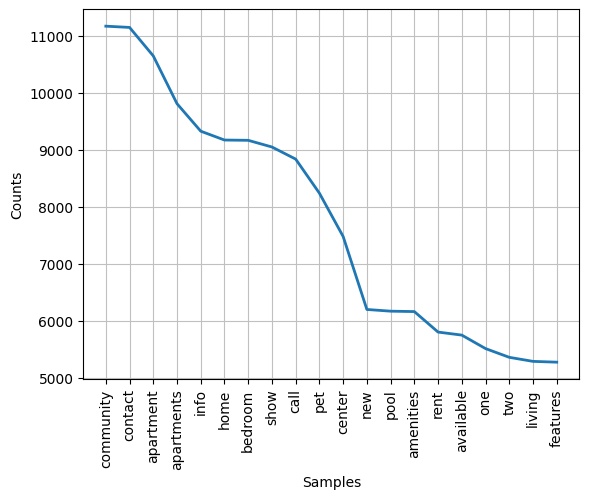

<Axes: xlabel='Samples', ylabel='Counts'>

In [ ]:
freq_dist.plot(20)

In [ ]:
# Initialising bigram
fd_bigram = FreqDist()

In [ ]:
bigrams = bigrams(cleaned_reviews)

In [ ]:
# To iterate each bigram and then add it to the freqDist
for bigram in bigrams:
  fd_bigram[bigram] = fd_bigram[bigram] + 1

In [ ]:
fd_bigram.most_common(5)

[(('contact', 'info'), 8882),
 (('show', 'contact'), 8694),
 (('washer', 'dryer'), 4543),
 (('fitness', 'center'), 3906),
 (('call', 'show'), 3126)]

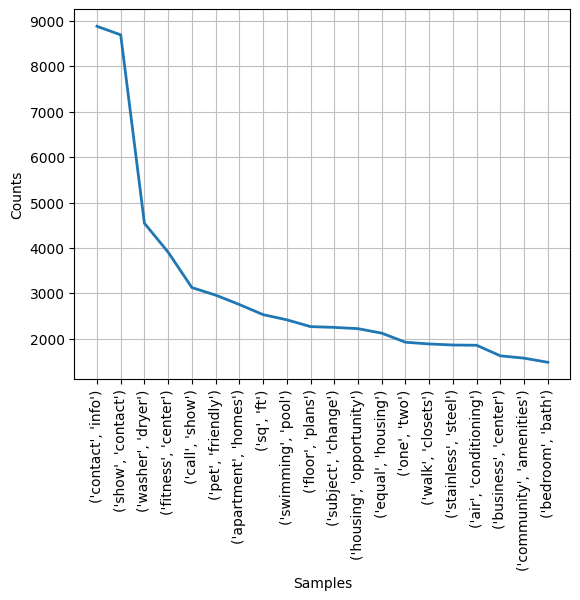

<Axes: xlabel='Samples', ylabel='Counts'>

In [ ]:
fd_bigram.plot(20)

In [ ]:
fd_trigram = FreqDist()

trigrams = trigrams(cleaned_reviews)

for trigram in trigrams:
  fd_trigram[trigram] = fd_trigram[trigram] + 1

In [ ]:
fd_trigram.most_common(5)

[(('show', 'contact', 'info'), 8693),
 (('call', 'show', 'contact'), 3126),
 (('equal', 'housing', 'opportunity'), 2070),
 (('stainless', 'steel', 'appliances'), 1449),
 (('availability', 'subject', 'change'), 1126)]

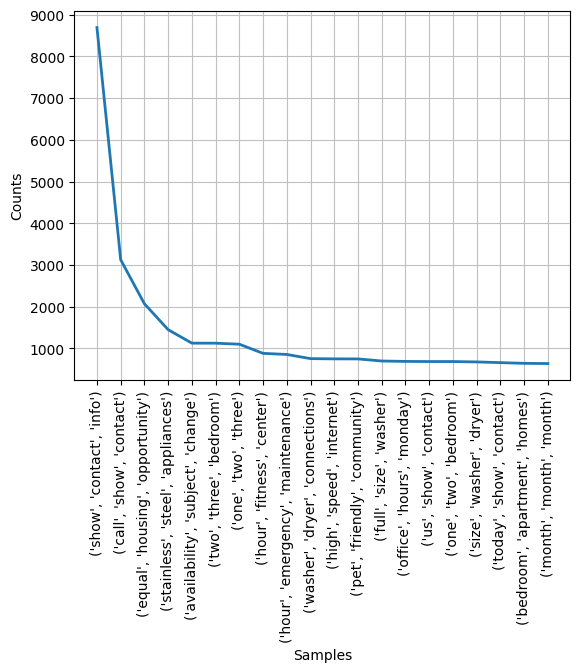

<Axes: xlabel='Samples', ylabel='Counts'>

In [ ]:
fd_trigram.plot(20)

GeoSpatial analysis the following data is needed:

 - longitude
 - latitude
 - price (weight)

In [ ]:
import folium

In [ ]:
from folium.plugins import HeatMap

In [ ]:
mp = folium.Map()
mp

In [ ]:
renting_data2.columns

Index(['id', 'url', 'region', 'region_url', 'price', 'type', 'sqfeet', 'beds',
       'baths', 'cats_allowed', 'dogs_allowed', 'smoking_allowed',
       'wheelchair_access', 'electric_vehicle_charge', 'comes_furnished',
       'laundry_options', 'parking_options', 'image_url', 'description', 'lat',
       'long', 'state'],
      dtype='object')

In [ ]:
HeatMap(data = renting_data2[['lat', 'long', 'price']], radius = 15).add_to(mp)

In [ ]:
mp

In [ ]:
renting_data2.columns

Index(['id', 'url', 'region', 'region_url', 'price', 'type', 'sqfeet', 'beds',
       'baths', 'cats_allowed', 'dogs_allowed', 'smoking_allowed',
       'wheelchair_access', 'electric_vehicle_charge', 'comes_furnished',
       'laundry_options', 'parking_options', 'image_url', 'description', 'lat',
       'long', 'state'],
      dtype='object')

 ** Analysis of Label Distribution**
    
    
    label_list = ['beds','baths', 'cats_allowed', 'dogs_allowed', 'smoking_allowed',
       'wheelchair_access', 'electric_vehicle_charge', 'comes_furnished']

     def label_distribution(feature):
             return sns.countplot(renting_data2[feature])

    for i in label_list:
         #in this case,we have to first mention figure and then draw distribution
         plt.figure(figsize=(15,5))
         label_distribution(i)

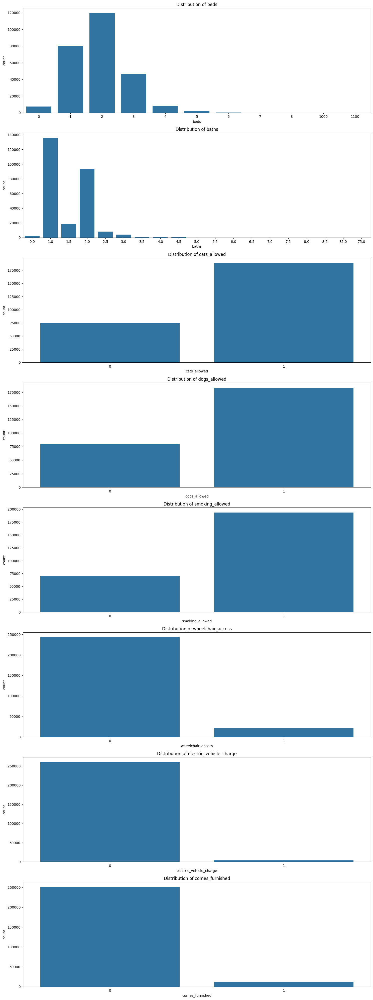

In [ ]:


label_list = ['beds','baths', 'cats_allowed', 'dogs_allowed', 'smoking_allowed',
   'wheelchair_access', 'electric_vehicle_charge', 'comes_furnished']

# Set up a grid of subplots for vectorized plotting
fig, axes = plt.subplots(nrows=len(label_list), figsize=(15, 5 * len(label_list)))

for ax, feature in zip(axes, label_list):
    sns.countplot(x=renting_data2[feature], ax=ax)
    ax.set_title(f"Distribution of {feature}")

plt.tight_layout()
plt.show()


**Addressing Outlayers**

<Axes: ylabel='price'>

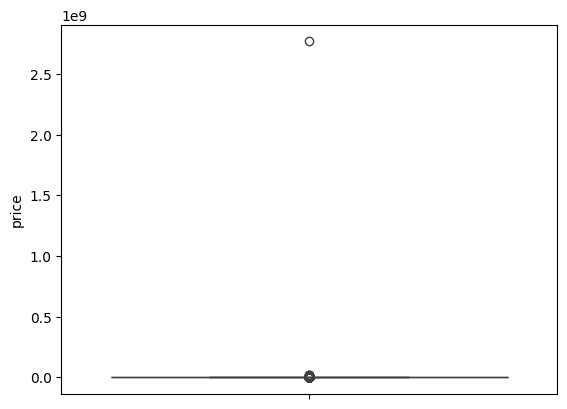

In [ ]:
sns.boxplot(renting_data2['price'])

<Axes: ylabel='price'>

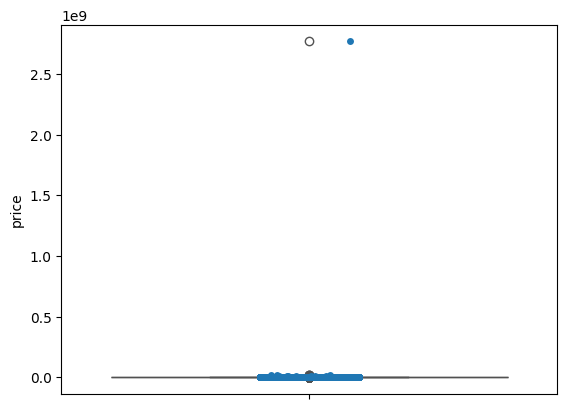

In [ ]:
sns.stripplot(renting_data2['price'])
sns.boxplot(renting_data2['price'])

<Axes: ylabel='baths'>

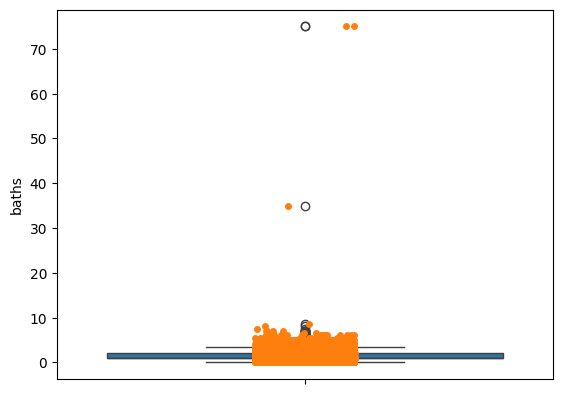

In [ ]:
sns.boxplot(renting_data2['baths'])
sns.stripplot(renting_data2['baths'])

**Pinpointing Oulliers**

In [ ]:
import statsmodels.api as sm

Text(0.5, 1.0, 'Normal QQPlot of Price')

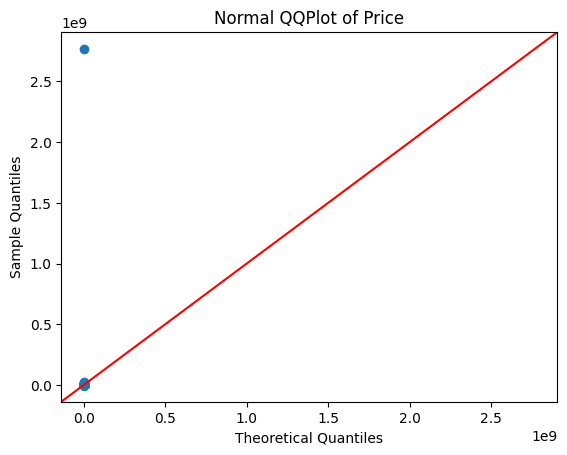

In [ ]:
#QQplot for price feature
sm.qqplot(renting_data2['price'], line = '45')
plt.title("Normal QQPlot of Price")

Text(0.5, 1.0, '#QQplot for sqfeet feature')

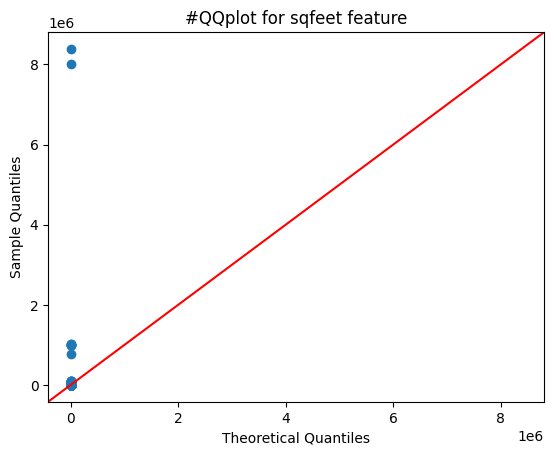

In [ ]:
#QQplot for sqfeet feature
sm.qqplot(renting_data2['sqfeet'], line ='45')
plt.title("#QQplot for sqfeet feature")

Text(0.5, 1.0, '#QQplot for bed feature')

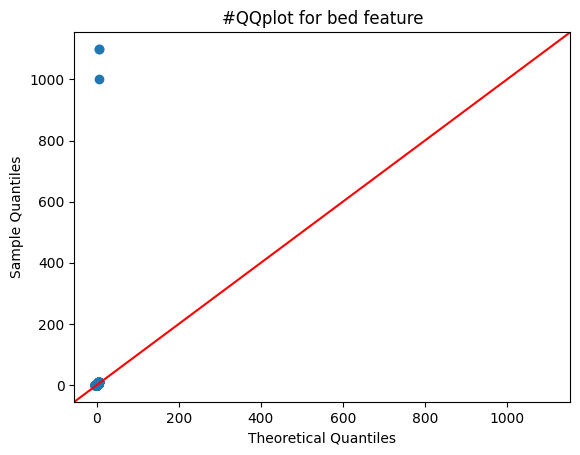

In [ ]:
sm.qqplot(renting_data2['beds'], line = '45')
plt.title("#QQplot for bed feature")

After detecting the outlier we should remove\treat the outlier
Outliers badly affect mean and standard deviation of the dataset.
It increases the error variance and reduces the power of statistical tests.
Most machine learning algorithms do not work well in the presence of outlier. So it is desirable to detect and remove outliers.
With all these reasons we must be careful about outlier and treat them before build a ML model.
There are some techniques used to deal with outliers.
 1. Deleting observations but thts not a professional approach,as in this case there is a information loss in our data.
    We delete outlier values if it is due to data entry error..

 2. Transforming values.
    Transforming variables can also eliminate outliers. These transformed values reduces the variation caused by extreme values.
    1. Scaling
    2. Log transformation
    3. Cube Root Normalization
    4. Box-Cox transformation

    * These techniques convert higher values of data to smaller values.
    * If the data has too many extreme values or skewed, this method helps to make your data normal.
    * But These technique not always give you the best results.
    * There is no lose of data from these methods.
    * In all these method boxcox transformation gives the best result.   


 3. Imputation by using some statistical techniques to deal with outliers like Median , Z-Score , IQR , Robust z-score

** Using Statistical Methods**

In [ ]:
renting_data2.shape

(263771, 22)

In [ ]:
imp_features = ['price', 'sqfeet', 'beds', 'baths']

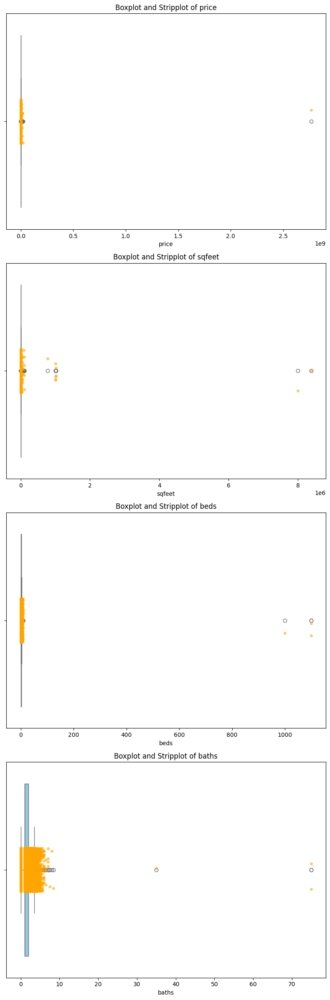

In [ ]:
# Set up a grid of subplots for vectorized plotting
fig, axes = plt.subplots(nrows=len(imp_features), figsize=(8, 6 * len(imp_features)))

for ax, feature in zip(axes, imp_features):
    sns.boxplot(x=renting_data2[feature], ax=ax, color='skyblue')
    sns.stripplot(x=renting_data2[feature], ax=ax, color='orange', alpha=0.6)
    ax.set_title(f"Boxplot and Stripplot of {feature}")

plt.tight_layout()
plt.show()

In [ ]:
import statsmodels.api as sm

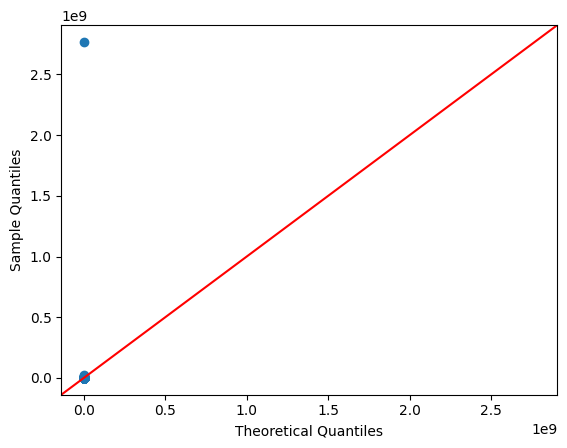

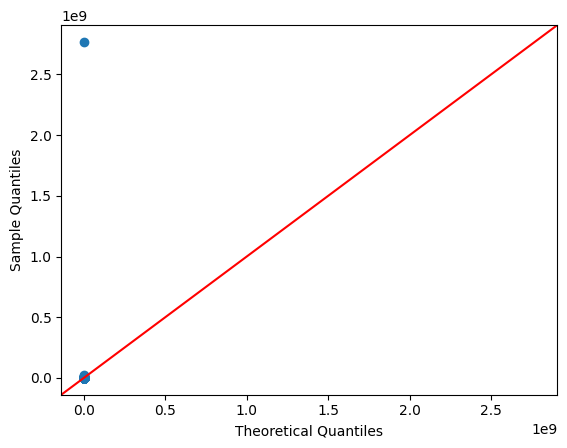

In [ ]:
sm.qqplot(renting_data2['price'], line = '45')
#plt.title("Normal QQPlot of Price")

In [ ]:
# Automating the code to include other features in the ggplot
def ggplot(renting_data2, col):
  plt.figure(figsize = (12, 8))
  sm.qqplot(renting_data2[col], line = '45')
  plt.title("Normal QQplot of {}".format(col))

<Figure size 1200x800 with 0 Axes>

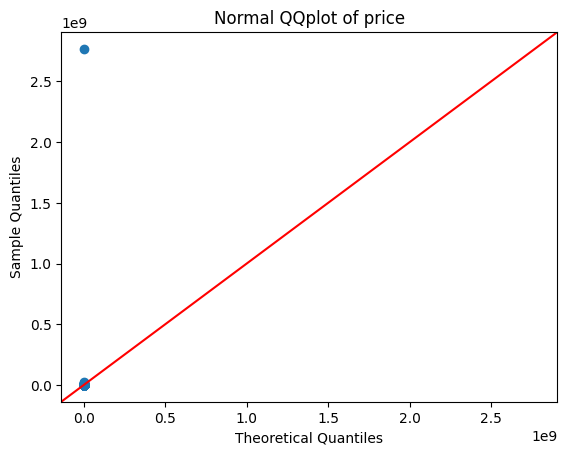

<Figure size 1200x800 with 0 Axes>

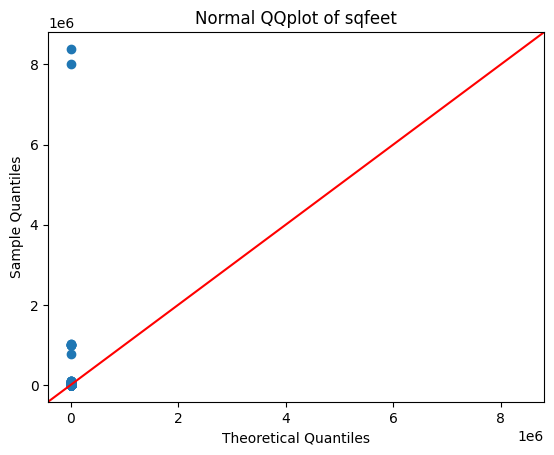

<Figure size 1200x800 with 0 Axes>

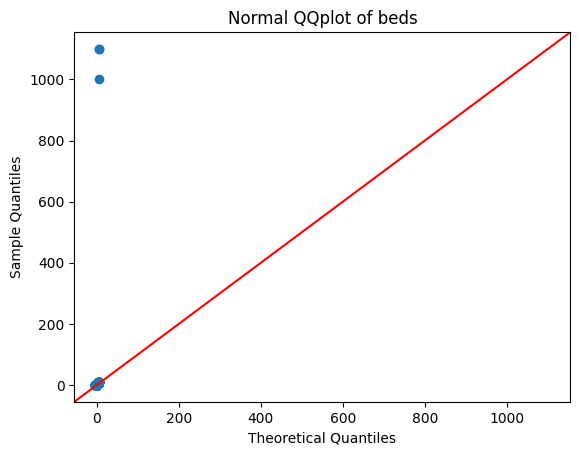

<Figure size 1200x800 with 0 Axes>

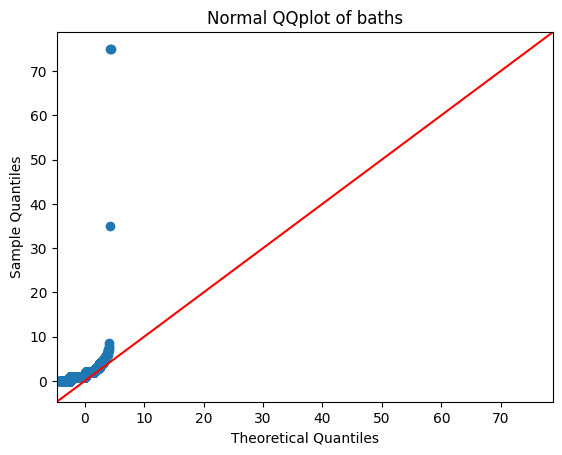

In [ ]:
for i in imp_features:
  ggplot(renting_data2, i)

# Outliers Imputation for numerical features

In [ ]:
renting_data3 = renting_data

In [ ]:
renting_data3['price']

,price
0,1195
1,1120
2,825
3,800
4,785
...,...
265184,929
265185,0
265186,1069
265187,1507


In [ ]:
renting_data3['price'].mean()

12330.078647766433

In [ ]:
renting_data3['price'].median()

1060.0

this is a case where the mean is greater than the median. This indicates that there are high positive outliers so, we are going to replaces any value in the price feature above 5000 with the median price of 1060 as shown above. The "np.where" function will be used for this operation

In [ ]:
sns.displot(renting_data3['price'])

In [ ]:
renting_data3['price'] = np.where(renting_data3['price']>5000, renting_data3['price'].median(), renting_data3['price'])

In [ ]:
renting_data3['price'].mean()

To automate the code to implement other features

In [ ]:
def imp_outliers(feature, threshold):
  renting_data3[feature] = np.where(renting_data3[feature]>threshold, renting_data3[feature].median(), renting_data3[feature])

calling the "imp_outlier" function on different features

In [ ]:
renting_data3.columns

In [ ]:
# to get the top 200 values of the "sqfeet" feature
renting_data3['sqfeet'].nlargest(200)

In [ ]:
# Implementing the function on the price feature
imp_outliers('price', 5000)

In [ ]:
sns.displot(renting_data3['price'])

In [ ]:
# Implementing the function. note the threshold figure is going to be provided by a subject matter expert
imp_outliers('sqfeet', 5000)

In [ ]:
sns.displot(renting_data3['sqfeet'])

In [ ]:
# Implementing the function on the beds feature
renting_data3['beds'].nlargest(200)

In [ ]:
imp_outliers('beds', 20)

In [ ]:
sns.distplot(renting_data3['beds'])

In [ ]:
# Implementing the function on the baths feature
renting_data3['baths'].nlargest(200)

In [ ]:
imp_outliers('baths', 10)

In [ ]:
sns.distplot(renting_data3['baths'])

comprehensive data analysis on the features' relationship to price feature

In [ ]:
plt.figure(figsize = (12, 8))
sns.distplot(renting_data3[renting_data3['dogs_allowed']== True]['price'], hist = False, label= 'Price distribution where dogs are allowed')
sns.distplot(renting_data3[renting_data3['dogs_allowed']== False]['price'], hist= False, label= 'Price distribution where dogs are not allowed')
plt.legend()
plt.title('Price distribution based on whether or not dogs_allowed feature')

Creating a function to implement on other features

In [ ]:
def price_dist(feature, label):
  plt.figure(figsize = (12, 8))
  sns.distplot(renting_data3[renting_data3[feature]== True]['price'], hist = False, label= 'Price distribution where {}'.format(feature))
  sns.distplot(renting_data3[renting_data3[feature]== False]['price'], hist= False, label= 'Price distribution where no {}'.format(feature))
  plt.legend()
  plt.title('Price distribution based on whether or not {} feature'.format(feature))

In [ ]:
price_dist('cats_allowed', 'cats')

In [ ]:
renting_data3.columns

In [ ]:
price_dist('smoking_allowed', 'smoking')

In [ ]:
price_dist('wheelchair_access', 'wheelchair')

In [ ]:
price_dist('electric_vehicle_charge', 'electric vehicle')

In [ ]:
price_dist('comes_furnished', 'furnished')

Reviewing the prices based on sqfeet

In [ ]:
import plotly.express as px

In [ ]:
px.scatter(renting_data3, x = 'sqfeet', y = 'price', color = 'baths')

Feature encoding

In [ ]:
renting_data4 = renting_data3.copy()

In [ ]:
# To drop irrelevant features
renting_data4.drop(['id', 'url', 'region_url', 'beds', 'baths', 'cats_allowed', 'image_url', 'description', 'lat','long',], axis = 1, inplace = True)

In [ ]:
renting_data4.shape

In [ ]:
renting_data4.dtypes

In [ ]:
# Extracting features where data type is object
object_categorical = [feature for feature in renting_data4.columns if renting_data4[feature].dtype == 'object']
object_categorical

For these five object categorical features, they require different feature encoding methods, so the challenge here is how to know which feature encoding technique to use for each of these columns.

first we need to check the unique sub-categories are there in each of the features.

In [ ]:
#
for feature in object_categorical:
  print("Total number of features in {} are {}".format(feature, len(renting_data4[feature].unique())))

In [ ]:
# For the region feature
pd.set_option('display.max_rows', 298)
region_count = renting_data4['region'].value_counts()
region_count

In [ ]:
# To check how many region has more than 500 entries
len(region_count[region_count>500])

In [ ]:
# I would want to display the regions that have over 500 entries
region_count[region_count>500]

In [ ]:
# Find the index of all the regions greater than 500
important_sub_cats = region_count[region_count>500].index
important_sub_cats

In [ ]:
# Let's group values based on their presence in the list of important_features above
def extract(x):
  if x in important_sub_cats:
    return x
  else:
    return 'Other'

In [ ]:
renting_data4['region'] = renting_data4['region'].apply(extract)
renting_data4['region']

In [ ]:
renting_data4['region'] = renting_data4['region'].apply(extract)

In [ ]:
renting_data4['region'].head(20)

In [ ]:
renting_data4['region'].tail(50)

In [ ]:
# A function to extract the number of unique values in a specified feature of the renting_data4 data
# and displays all output(unique values) on the screen when the function is called.
def stat_retrieve(feature):
  count = renting_data4[feature].value_counts()
  pd.set_option('display.max_rows', renting_data4[feature].nunique())
  return count

In [ ]:
stat_retrieve('state')

In [ ]:
# A function to identify the important subcategories by extracting those with occurrences greater than a threshold
# which will be provided by a domain expert in an organization. Then the indices which contains the subcategory names are returned.
def extract_imp_sub_cats(feature, threshold):
  count = renting_data4[feature].value_counts()
  important_sub_cats = count[count>threshold].index
  return important_sub_cats

In [ ]:
sub_category = extract_imp_sub_cats('state', 2000)
sub_category

In [ ]:
# For the type feature
stat_retrieve('type')

In [ ]:
# For the type feature
stat_retrieve('type')

In [ ]:
renting_data4['state'] = renting_data4['state'].apply(lambda x: x if x in sub_category else 'Other')

In [ ]:
renting_data4['type'] = renting_data4['type'].apply(lambda x: x if x in imp2 else 'Other')

In [ ]:
renting_data4['type'].nunique()

In [ ]:
renting_data4['state'].nunique()

In [ ]:
for feature in object_categorical:
  print("Total number of features in {} are {}".format(feature, len(renting_data4[feature].unique())))

In [ ]:
#
dictionary = dict(renting_data4['region'].value_counts())
dictionary

In [ ]:
#
renting_data4['region'] = renting_data4['region'].map(dictionary)

In [ ]:
renting_data4['region']

In [ ]:
!pip install category_encoders

In [ ]:
from category_encoders import CountEncoder

In [ ]:
renting_data4['state'].head()

In [ ]:
pd.set_option('display.max_rows', 33)
renting_data4['state'].value_counts()

In [ ]:
# Initializing the count encoder
count_enc = CountEncoder()

In [ ]:
# Applying the count encoder
renting_data4['state'] = count_enc.fit_transform(renting_data4['state'])

Label Encoding on type feature

In [ ]:
from sklearn.preprocessing import LabelEncoder

In [ ]:
lab_enc = LabelEncoder()

In [ ]:
# lab_enc.fit_transform(renting_data4['type'])

In [ ]:
for feature in ['laundry_options', 'parking_options', 'type']:
  renting_data4[feature] = lab_enc.fit_transform(renting_data4[feature])

In [ ]:
renting_data4.head()

In [ ]:
renting_data4.dtypes

In [ ]:
from sklearn.model_selection import train_test_split

from sklearn.neighbors import KNeighborsRegressor
from sklearn.tree import DecisionTreeRegressor
from sklearn.ensemble import RandomForestRegressor
from sklearn.linear_model import LinearRegression
from sklearn.metrics import r2_score
from sklearn.model_selection import cross_val_score
from sklearn.model_selection import GridSearchCV

In [ ]:
x = renting_data4.drop('price', axis = 1)

In [ ]:
y = renting_data4['price']

In [ ]:
# setting random seed
np.random.seed(42)

x_train, x_test, y_train, y_test = train_test_split(x, y, test_size = 0.2)

dec_tree = DecisionTreeRegressor()
dec_tree.fit(x_train, y_train)

In [ ]:
y_preds = dec_tree.predict(x_test)

In [ ]:
y_preds

In [ ]:
print(r2_score(y_test, y_preds))

In [ ]:
#
models = []
models.append(("Linear Regression", LinearRegression()))
models.append(("Decision Tree", DecisionTreeRegressor()))
models.append(("Random Forest", RandomForestRegressor()))
models.append(("KNN", KNeighborsRegressor()))

In [ ]:
for name, model in models:
  print(name)
  model.fit(x_train, y_train)
  y_preds = model.predict(x_test)

  print(r2_score(y_test, y_preds))
  y_preds = model.predict(x_test)

  print(r2_score(y_test, y_preds))

In [ ]:
# List of models
models = [
    ("Linear Regression", LinearRegression()),
    ("Decision Tree", DecisionTreeRegressor()),
    ("Random Forest", RandomForestRegressor()),
    ("KNN", KNeighborsRegressor())
]

# Function to train and evaluate each model
def train_and_evaluate(model_tuple):
    name, model = model_tuple
    model.fit(x_train, y_train)
    y_preds = model.predict(x_test)
    r2 = r2_score(y_test, y_preds)
    return name, r2

# Using map to avoid for-loop and train/evaluate models
results = list(map(train_and_evaluate, models))

# Print results
for name, r2 in results:
    print(f"{name}: R-squared = {r2:.4f}")

In [ ]:
RandomForestRegressor()

In [ ]:
n_estimators = [int(x) for x in np.linspace(start = 100, stop = 1200, num = 5)]
max_features = ['auto', 'sqrt']
max_depth = [int(x) for x in np.linspace(5, 30, num = 3)]
min_samples_split = [2, 5, 10, 15, 100]
min_samples_leaf = [1, 2, 5, 10]

In [ ]:
pd.read_csv('C:\Users\HP\Downloads\housing_train.csv')

In [ ]:
# vectorised
random_grid = {
    'n_estimators': np.linspace(start=100, stop=1200, num=5, dtype=int).tolist(),
    'max_features': ['auto', 'sqrt'],
    'max_depth': np.linspace(5, 30, num=3, dtype=int).tolist(),
    'min_samples_split': [2, 5, 10, 15, 100],
    'min_samples_leaf': [1, 2, 5, 10]
}


In [ ]:
#Saving the model
import pickle

pickle.dump(rfclf_model, open("playstore_review_ratings.pkl", "wb"))

In [ ]:
open_model = pickle.load(open("playstore_review_ratings.pkl", "rb"))